# Assessment of Wildland Urban Interface areas

This notebook will implement the WUIX2 software, which assesses the Wildland Urban Interface (WUI) areas and evaluates the results. For that, the code follows the steps:
1. Collection of the orthoimage of the defined surrounding region for the study area;
2. Apply and compare different indexes for identification of the vegetation and define the most adequate for the next steps;
3. Prepare the required files for WUIX2 based on the identified vegetation and vectors of existing houses;
4. Apply the WUIX methodology through the WUIX2 software;
5. Show preliminary results and apply the standardized colour plot.

### Import needed libraries

In [73]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import os

## 1. Collection of the orthoimage of the defined surrounding region for the study area

### Data for the heading of the file and preparation

#### Must be filled according to the data

* General inputs

--> "village_name" will name the folders and others

--> "n_number" is a coefficient and the only input given to the prompt when it starts running WUIX2.exe (number of bigcells)

--> "size_Rf" is the size of the image resolution, WUIX2.exe will use this number as "malha fina"

--> the images will be collected based on it "image_year" 

--> "srs" georreference of the images and shape files

--> "size" approximately the size of the rectangule in meters 

--> "nodata_value" always equal to '-9999' for this methodology

#### Collect geographical coordinates to draw a Bounding Box

In [74]:
def create_empty_coordinate_dbase(filepath, columns):
    '''
    Create an empty CSV file to store village geographical coordinates.
    '''
    
    folders = filepath[:filepath.rfind('/')]
    if not os.path.exists(folders):
        os.makedirs(folders)

    db_coordinates = pd.DataFrame(columns=columns)
    db_coordinates = db_coordinates.to_csv(filepath, header=True, index=False)
    
    return print('File not found, an empty one was created')

def populate_coordinate_dbase_manually(filepath, columns):
    '''
    Update the geographical coordinates of the villages using the data provided by the user. 
    The data is stored in the existing database file.
    '''

    db_coordinates = pd.read_csv(filepath, header=0)
    row = {}
    
    for column in columns:
        if column == 'index':
            if db_coordinates.empty:
                index_value = 0
            else:
                index_value = db_coordinates['index'].tail(1).values[0] + 1
            row[column] = index_value
        else:
            value = input(f'Enter a value for {column}:     ')
            row[column] = str(value)
    
    row_to_df = pd.DataFrame([row])
    db_coordinates = pd.concat([db_coordinates, row_to_df], ignore_index=True)
    
    db_coordinates.to_csv(filepath, header=True, index=False)

    return

### Dropdown box for choice of the village
* Run the script until here and the database will be load. Then choose the village to proceed.

In [75]:
import ipywidgets as widgets
from IPython.display import display

data_base = '../data/village_coordinates/village_coordinates.csv'
columns = ['index', 'village', 'city/region', 'lat', 'lon']


if not os.path.exists(data_base):
    create_empty_coordinate_dbase(data_base, columns)

db_coordinates = pd.read_csv(data_base, header=0)

dropdown_options = [''] + ['Set new village'] + list(db_coordinates['village'])
village_dropdown = widgets.Dropdown(options=dropdown_options, description='Village:')
output = widgets.Output()

# Define a function to handle changes in the dropdown's value
def handle_dropdown_change(change):
    selected_value = change.new
    output.clear_output()
    
    if selected_value == '':
        with output:
            print('Please choose a village.')
    
    elif selected_value == 'Set new village':
        with output:
            print('Provide the village data')
            
            temp_dict = {}
            for item in columns:
                temp_dict[item] = widgets.Text(description=f'{item}:')
            
            add_button = widgets.Button(description='Add Row')
            display(*temp_dict.values(), add_button)
            
            def add_row(button_click):
                global db_coordinates
                new_row = {}
                for item, input_value in temp_dict.items():
                    new_row[item] = input_value.value
                db_coordinates = pd.concat([db_coordinates, pd.DataFrame([new_row])], ignore_index=True)
                db_coordinates.to_csv(data_base, index=False)
                print(f'New row added:\n{new_row}')
            
            #db_coordinates['village'].tail(1)

            add_button.on_click(add_row)
    
    else:
        selected_row = db_coordinates[db_coordinates['village'] == selected_value]
        with output:
            print('Selected Village Information:\n')
            print(selected_row)

# Set the dropdown's change event handler
village_dropdown.observe(handle_dropdown_change, names='value')

# Display the widgets
display(village_dropdown, output)

Dropdown(description='Village:', options=('', 'Set new village', 'Montesinho', 'Aveleda', 'Rio de Onor', 'Cova…

Output()

#### Village data

In [109]:
if village_dropdown.value == 'Set new village':
    village_name = db_coordinates.iloc[-1,1] # Apply the last appended village to the database. 
elif village_dropdown.value == '':
    try:
        village_name = village['name'] # Apply the village used previously.
    except NameError:
        village_name = db_coordinates.iloc[-1,1] # Apply the last appended village to the database.
else:
    village_name = village_dropdown.value
    
village = {
            # Must be adapted each time to get specific results.
            'name': village_name,
            'year': '2015', #just for the years [2015, 2018, 2021], others do not have 'IRG' images
            'n_number': '40',
            'size_Rf': 1,

            ### May be adapted in case of more specific needs.
            'srs': "EPSG:4326",
            'size': [1500, 1500],
            'nodata_value': '0'
           }
village

{'name': 'Figueira',
 'year': '2015',
 'n_number': '40',
 'size_Rf': 1,
 'srs': 'EPSG:4326',
 'size': [1500, 1500],
 'nodata_value': '0'}

#### Create a directory for outputs

* In the case of non-existent "Images", "Outputs", "Outputs/'village_name'" or "Images/'village_name'" folders, it creates a new one

In [110]:
output_path = f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}'
images_path = f'../wui_application/images/{village["name"]}/{village["year"]}'
shapefile_path = f'../data/shape_files/{village["name"]}/buildings'

paths = [output_path, images_path, shapefile_path]

for path in paths:
    if not os.path.exists(path):
        os.makedirs(path)

#### Might be checked according to the data

- Georeference

--> "xllcorner", "xllcorner" = They will define the properties of the images
(suggestion: Do not change it and let it calculate based on the coordinates of the village)

* The specified offsets are based on previous experience and provide sufficient coverage for most villages. However, they can be adjusted for larger sites.

In [111]:
db_coordinates

,index,village,city/region,lat,lon
0,3,Montesinho,Braganca,41.939038,-6.765422
1,4,Aveleda,Braganca,41.890574,-6.696835
2,5,Rio de Onor,Braganca,41.940190,-6.616248
3,1,Cova da Lua,Braganca,41.889052,-6.822157
4,2,Moimenta,Vinhais,41.950936,-6.974990
5,6,Montouto,Vinhais,41.928179,-6.990103
6,7,Pinheiro Velho,Braganca,41.958670,-7.115959
7,9,Pinheiro Novo,Vinhais,41.964659,-7.138300
8,8,Figueira,Pedrogão Grande,39.922361,-8.233425
9,10,Sarzedas de Sao Pedro,Castanheira da Pera,39.960141,-8.215666


In [113]:
import math
#def calculate_min_max_coordinates(village):

EARTH_RADIUS = 6371000  # meters
displacement_x = math.degrees(village["size"][0] / (2 * EARTH_RADIUS))
displacement_y = math.degrees(village["size"][1] / (2 * EARTH_RADIUS))

## with specified START

#lat_rad = math.radians(village["lat"])
#lon_rad = math.radians(village["lon"])
#lat = db_coordinates.loc[db_coordinates['village'] == village['name']].iloc[0, 3]
#lon = db_coordinates.loc[db_coordinates['village'] == village['name']].iloc[0, 4]

# Import attributes of building shapefile and define the center of it
image_buildings = gpd.read_file(f'../data/shape_files/{village["name"]}/buildings/{village["name"]}.shp')
poly_bounds = image_buildings.bounds[['minx', 'miny', 'maxx', 'maxy']]
external_bounds = {'min_x' : poly_bounds['minx'].min(),
                   'min_y' : poly_bounds['miny'].min(),
                   'max_x' : poly_bounds['maxx'].max(),
                   'max_y' : poly_bounds['maxy'].max()}

lat = external_bounds['min_y'] + ((external_bounds['max_y'] - external_bounds['min_y']) / 2)
lon = external_bounds['min_x'] + ((external_bounds['max_x'] - external_bounds['min_x']) / 2)

miny = lat - displacement_y
maxy = lat + displacement_y
minx = math.degrees(math.radians(lon - displacement_x) / math.cos(math.radians((maxy - miny) / 2)))
maxx = math.degrees(math.radians(lon + displacement_x) / math.cos(math.radians((maxy - miny) / 2)))
village.update({'bounds' : {'minx' : minx, 
                            'miny' : miny, 
                            'maxx' : maxx, 
                            'maxy' : maxy}})

village

{'name': 'Figueira',
 'year': '2015',
 'n_number': '40',
 'size_Rf': 1,
 'srs': 'EPSG:4326',
 'size': [1500, 1500],
 'nodata_value': '0',
 'bounds': {'minx': -8.238677953804158,
  'miny': 39.915521016487965,
  'maxx': -8.225188129621907,
  'maxy': 39.929010840576744}}

In [80]:
import json

json_file_path = f'./{village["name"]}/village_info.json'

if not os.path.exists(str.rsplit(json_file_path, "/", 1)[0]):
    os.makedirs(str.rsplit(json_file_path, "/", 1)[0])

with open(json_file_path, 'w') as json_file:
    json.dump(village, json_file, indent=4)

In [81]:
#get capabilities from wms service through url

from owslib.wms import WebMapService

def connect_service(year):
    orthophoto_url = f'https://cartografia.dgterritorio.gov.pt/wms/ortos{year}?service=wms&request=getcapabilities'
    orthophoto_service = WebMapService(orthophoto_url, version="1.3.0")
    return orthophoto_service

print(list(connect_service(village["year"]).contents), '\n',
           connect_service(village["year"])[f'Ortos{village["year"]}-IRG'].crsOptions, '\n',
           connect_service(village["year"]).getOperationByName('GetMap').formatOptions, '\n',
           connect_service(village["year"]).contents[f'Ortos{village["year"]}-IRG'].boundingBoxWGS84)

['Ortos', 'Ortos2015-RGB', 'Ortos2015-IRG', 'Enquadramento_Ortos2015'] 
 ['EPSG:3763', 'EPSG:4326', 'EPSG:3857', 'EPSG:4258'] 
 ['image/png', 'image/jpeg', 'image/png; mode=8bit', 'image/vnd.jpeg-png', 'image/vnd.jpeg-png8', 'application/x-pdf', 'image/svg+xml', 'image/tiff', 'application/vnd.google-earth.kml+xml', 'application/vnd.google-earth.kmz', 'application/x-protobuf', 'application/json'] 
 (-10.1934, 36.7643, -5.70954, 42.2796)


In [82]:
def download_and_save_image(village_attributes, image_type_color):
    '''
    Download and save image data based on user-defined parameters.

    Parameters:
    - village_attributes (dict): Attributes of the village.
    - image_type (str): The type of image to be taken.

    This function connects to a service, collects image, and saves it to a specified file.
    '''
    if image_type_color == 'nir':
        i_type = 'IRG'
    else:
        i_type = 'RGB'
    
    in_image = connect_service(village["year"]).getmap(
                                                 layers=[f'Ortos{village["year"]}-{i_type}'],
                                                 size=village["size"],
                                                 srs=village["srs"],
                                                 bbox=list(village["bounds"].values()),
                                                 format="image/tiff")

    image_path = f'../wui_application/images/{village["name"]}/{village["year"]}/image_{image_type_color}_{village["size_Rf"]}.tif'

    if os.path.exists(image_path):
        os.remove(image_path)

    with open(image_path, 'wb') as out:
        out.write(in_image.read())
    
    return

In [83]:
im_type_color = ['nir', 'rgb']

for item in im_type_color:
    download_and_save_image(village, item)

## 2. Apply and compare different indexes for identification of the vegetation and define the most adequate for the next steps

### Preparation of the vegetation

#### Importing photos
* color = RGB
* near infrared = NIR

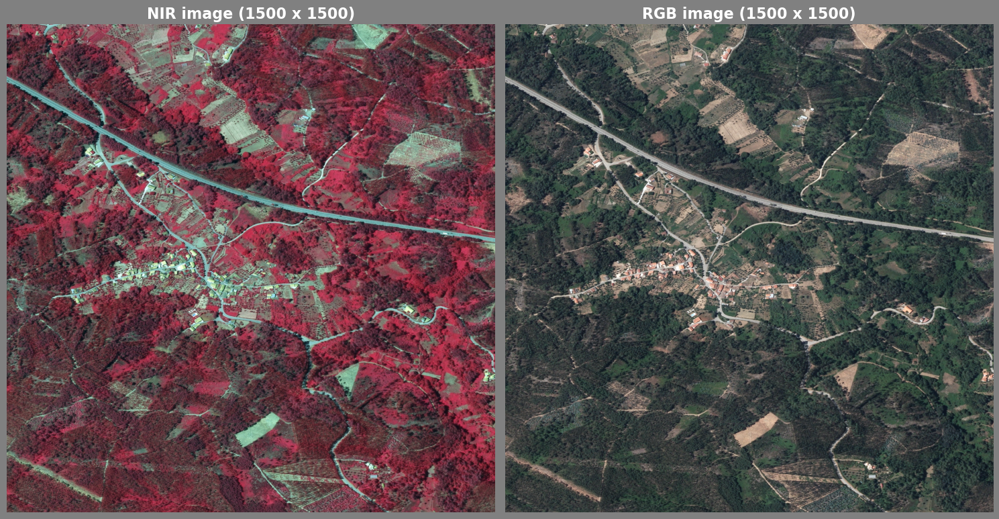

In [84]:
plt.rcParams.update({'figure.autolayout': True})

image_nir_rgb = []

fig, ax = plt.subplots(1,2, figsize=(15, 15), facecolor='gray')

for idx, item in enumerate(im_type_color):
    image_path = plt.imread(f'../wui_application/images/{village["name"]}/{village["year"]}/image_{item}_{village["size_Rf"]}.tif')
    
    ax[idx].imshow(image_path)
    ax[idx].axis('off')
    ax[idx].set_title(f'{item.upper()} image ({image_path.shape[1]} x {image_path.shape[0]})', 
                        color='white', fontweight='bold', fontsize='16')
    
    image_nir_rgb.append(image_path)

image_nir_rgb = np.array(image_nir_rgb)

plt.show()

#### Convert array of RGBA numbers (three dimensional) into an one channel array (two dimensional)

In [85]:
#np.set_printoptions(threshold=0)
image_nir_rgb[:, :, 0], image_nir_rgb[:, :, 1]

(array([[[125,  50,  63],
         [125,  49,  63],
         [125,  48,  62],
         ...,
         [103,  64,  65],
         [ 73,  48,  47],
         [ 91,  60,  58]],
 
        [[ 50,  63,  62],
         [ 49,  63,  63],
         [ 48,  62,  62],
         ...,
         [ 64,  65,  64],
         [ 48,  47,  48],
         [ 60,  58,  64]]], dtype=uint8),
 array([[[118,  49,  62],
         [121,  50,  61],
         [124,  48,  60],
         ...,
         [114,  75,  77],
         [ 93,  60,  61],
         [ 78,  53,  53]],
 
        [[ 49,  62,  62],
         [ 50,  61,  63],
         [ 48,  60,  62],
         ...,
         [ 75,  77,  74],
         [ 60,  61,  60],
         [ 53,  53,  54]]], dtype=uint8))

In [86]:
image_nir_rgb[0].shape, image_nir_rgb[1].shape

((1500, 1500, 3), (1500, 1500, 3))

In [87]:
nir_channel = np.delete(image_nir_rgb[0], (1,2), 2)
green_channel = np.delete(image_nir_rgb[1], (0,2), 2)
red_channel = np.delete(image_nir_rgb[1], (1,2), 2)
blue_channel = np.delete(image_nir_rgb[1], (0,1),2)

nir_channel = np.squeeze(nir_channel)
green_channel = np.squeeze(green_channel)
red_channel = np.squeeze(red_channel)
blue_channel = np.squeeze(blue_channel)
nir_channel, green_channel, red_channel, blue_channel


(array([[125, 118, 107, ...,  39,  52,  58],
        [125, 121, 115, ...,  48,  48,  53],
        [125, 124, 117, ...,  56,  45,  53],
        ...,
        [103, 114, 108, ...,  95, 102,  94],
        [ 73,  93,  97, ..., 131, 125, 115],
        [ 91,  78,  77, ...,  80,  92,  85]], dtype=uint8),
 array([[ 63,  62,  55, ...,  33,  42,  50],
        [ 63,  61,  56, ...,  41,  44,  49],
        [ 62,  60,  55, ...,  49,  39,  46],
        ...,
        [ 65,  77,  76, ...,  76,  79,  70],
        [ 47,  61,  64, ..., 110, 102,  92],
        [ 58,  53,  49, ...,  57,  68,  61]], dtype=uint8),
 array([[ 50,  49,  40, ...,  25,  34,  41],
        [ 49,  50,  44, ...,  32,  37,  41],
        [ 48,  48,  41, ...,  41,  35,  41],
        ...,
        [ 64,  75,  75, ...,  75,  79,  72],
        [ 48,  60,  63, ..., 112, 100,  89],
        [ 60,  53,  48, ...,  62,  69,  62]], dtype=uint8),
 array([[ 62,  62,  56, ...,  38,  50,  57],
        [ 63,  63,  60, ...,  49,  49,  56],
        [ 62,  6

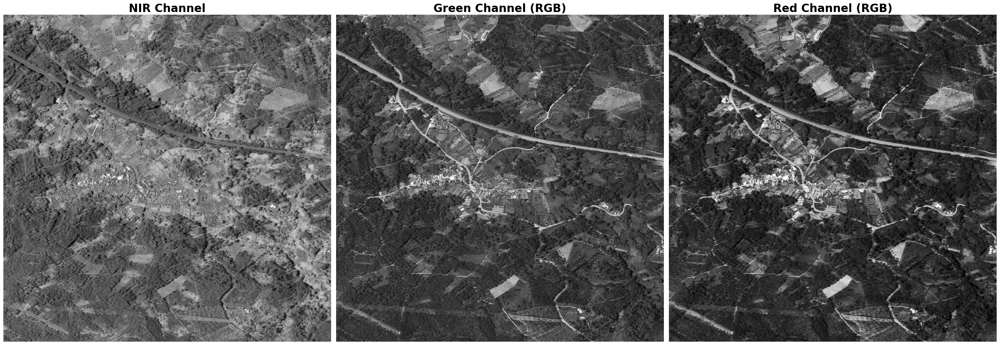

In [88]:
data = [nir_channel, green_channel, red_channel]
label_data = ['NIR Channel', 'Green Channel (RGB)', 'Red Channel (RGB)']

fig, ax = plt.subplots(1,3, figsize=(30, 15))

for idx in range(3):
    ax[idx].imshow(data[idx], cmap='gray')
    ax[idx].axis('off')
    ax[idx].set_title(f'{label_data[idx]}', fontweight='bold', fontsize='24')

plt.show()

#### Extract the "RGB image - green channel" from NIR "image - red channel"

In [89]:
r, g = red_channel.astype(float), green_channel.astype(float)
b, nir = blue_channel.astype(float), nir_channel.astype(float)

with np.errstate(divide='ignore', invalid='ignore'):
    array1_green = np.nan_to_num(np.divide( (nir - g), (nir + g), 
                                out=np.zeros_like(nir).astype(float)), copy=False)
    array2_red = np.nan_to_num(np.divide( (nir - r), (nir + r), 
                              out=np.zeros_like(nir).astype(float)), copy=False)

    array2_green = np.nan_to_num(np.divide( (g - nir), (g + nir), 
                                out=np.zeros_like(g).astype(float)), copy=False)

array2_green[0:5]

array([[-0.32978723, -0.31111111, -0.32098765, ..., -0.08333333,
        -0.10638298, -0.07407407],
       [-0.32978723, -0.32967033, -0.34502924, ..., -0.07865169,
        -0.04347826, -0.03921569],
       [-0.3368984 , -0.34782609, -0.36046512, ..., -0.06666667,
        -0.07142857, -0.07070707],
       [-0.32972973, -0.34042553, -0.3220339 , ..., -0.06666667,
        -0.11278195, -0.07913669],
       [-0.35897436, -0.36144578, -0.32183908, ..., -0.10691824,
        -0.08379888, -0.07428571]])

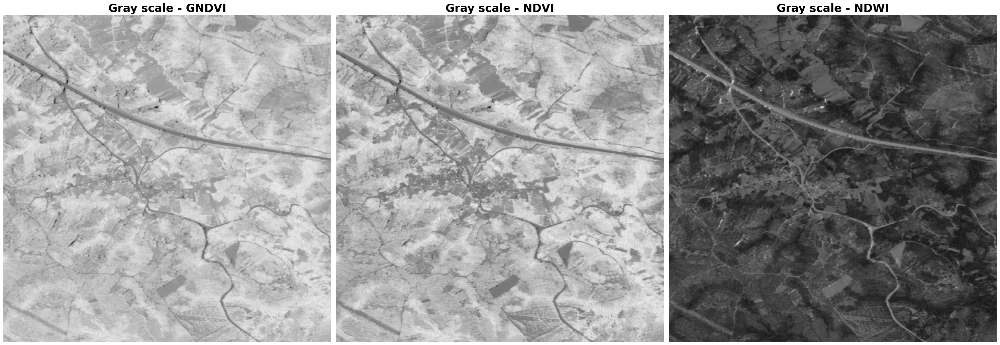

In [90]:
data = [array1_green, array2_red, array2_green]
label_data = ['Gray scale - GNDVI', 'Gray scale - NDVI', 'Gray scale - NDWI']

fig, ax = plt.subplots(1,3, figsize=(30, 15))

for idx in range(3):
    ax[idx].imshow(data[idx], cmap='gray')
    ax[idx].axis('off')
    ax[idx].set_title(f'{label_data[idx]}', fontweight='bold', fontsize='24')

plt.show()

In [91]:
(array1_green.size, array1_green.shape), (array2_red.size, array2_red.shape)
array2_green[:5]

array([[-0.32978723, -0.31111111, -0.32098765, ..., -0.08333333,
        -0.10638298, -0.07407407],
       [-0.32978723, -0.32967033, -0.34502924, ..., -0.07865169,
        -0.04347826, -0.03921569],
       [-0.3368984 , -0.34782609, -0.36046512, ..., -0.06666667,
        -0.07142857, -0.07070707],
       [-0.32972973, -0.34042553, -0.3220339 , ..., -0.06666667,
        -0.11278195, -0.07913669],
       [-0.35897436, -0.36144578, -0.32183908, ..., -0.10691824,
        -0.08379888, -0.07428571]])

In [92]:
maxmin1 = np.array([np.amin(array1_green), np.amax(array1_green)])
maxmin2 = np.array([np.amin(array2_red), np.amax(array2_red)])
maxmin1 = np.array([np.amin(array2_green), np.amax(array2_green)])

(maxmin1.astype(np.float16), 
 maxmin2.astype(np.float16), 
 maxmin2.astype(np.float16))

(array([-0.6035,  1.    ], dtype=float16),
 array([-1.    ,  0.7754], dtype=float16),
 array([-1.    ,  0.7754], dtype=float16))

#### Convert number range obtained from the previous calculation to a percentage (0-1)

In [93]:
# 1. Make all of the values superior to 0 adding '1'
# 2. Divide per the maximum value of this range '2'

norm_perc_green = np.divide((array1_green + 1), 2)
norm_perc_red = np.divide((array2_red + 1), 2)
norm_perc_green2 = np.divide((array2_green + 1), 2)

print(np.amin(norm_perc_green).astype(np.float16), 
      np.amax(norm_perc_green).astype(np.float16)), 
print(np.amin(norm_perc_red).astype(np.float16), 
      np.amax(norm_perc_red).astype(np.float16))


0.0 0.802
0.0 0.8877


In [94]:
# The average used to calculate the mean value where the array[0-1] will be 
# rounded only in values after 0,55 (vegetation values).
#  
# In this way, normalized_percentage is not rounding values 
# that are considered non corresponding to vegetation.

def weights(data):
    round_limit = 50
    weights = np.floor(np.divide(np.ceil(np.multiply(data, 100)), round_limit)).astype(np.float32)
    
    return weights

avg_green = np.average(norm_perc_green, weights=weights(norm_perc_green))
avg_red = np.average(norm_perc_red, weights=weights(norm_perc_red))

avg_green.astype(np.float16), avg_red.astype(np.float16)

(0.6006, 0.6416)

### Seaborn visualization

c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated

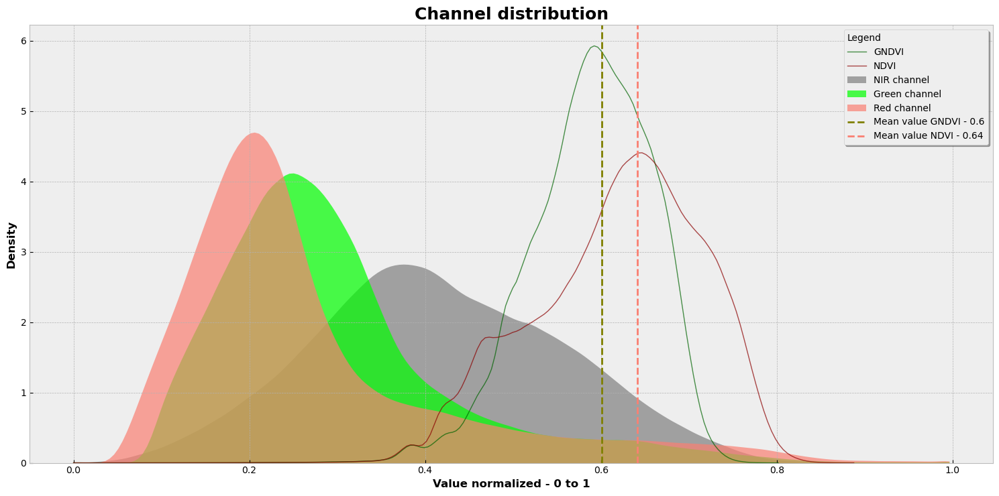

In [95]:
import seaborn as sns

nir_norm = nir_channel/256
g_norm = green_channel/256
r_norm = red_channel/256

channels = [norm_perc_green.ravel(), norm_perc_red.ravel(), nir_norm.ravel(), g_norm.ravel(), r_norm.ravel()]
labels = ['GNDVI', 'NDVI', 'NIR channel', 'Green channel', 'Red channel']
colors = ['darkgreen', 'darkred', 'grey', 'lime', 'salmon']
lines = [1, 1, 0, 0, 0]


plt.style.use('bmh')
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(15, 7.5), facecolor='white')

for channel, label, color, line in zip(channels, labels, colors, lines):
    sns.kdeplot(channel, label=label, common_norm=True, fill=not line, color=color, alpha=0.7, linewidth=line, cut=0)


axs.axvline(avg_green, linestyle="--", label=f'Mean value GNDVI - {str(round(avg_green, 2))}', c='olive', linewidth=2)
axs.axvline(avg_red, linestyle="--", label=f'Mean value NDVI - {str(round(avg_red, 2))}', c='salmon', linewidth=2)

axs.set_xlabel('Value normalized - 0 to 1', c='black', fontsize=12, fontweight='bold')
axs.set_ylabel('Density', c='black', fontsize=12, fontweight='bold')

axs.legend(title='Legend', frameon=True, alignment='left', fontsize=10, shadow=True)

axs.set_title('Channel distribution', c='black', fontsize=18, fontweight='bold')

plt.show()

c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\dener\ml_projects\WUIX_implementation\env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated

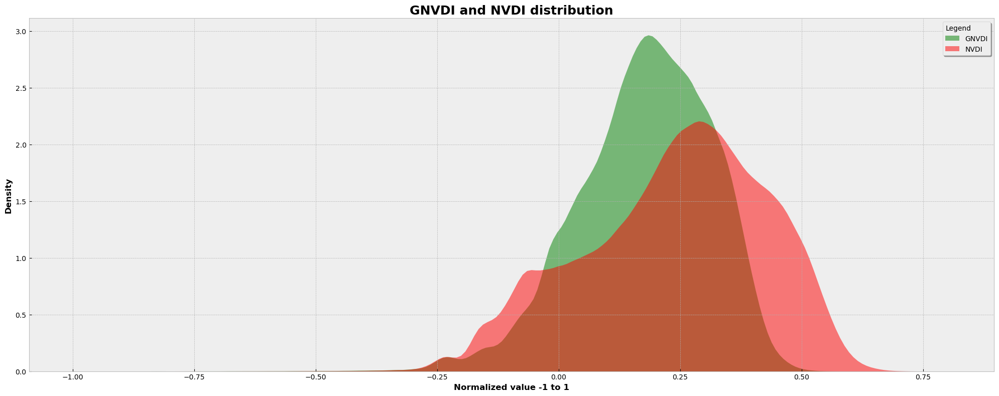

In [96]:
fig, ax = plt.subplots(1,1, figsize=(20, 8))

ax = sns.kdeplot(array1_green.ravel(), label='GNVDI', common_norm=True, 
                 fill=True, color="g", alpha=.5, linewidth=0, clip=[-1,1])

ax = sns.kdeplot(array2_red.ravel(), label='NVDI', common_norm=True, 
                 fill=True, color="r", alpha=.5, linewidth=0, clip=[-1,1])


ax.set_xlabel('Normalized value -1 to 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Density', fontsize=12, fontweight='bold')

ax.legend(title='Legend', alignment='left', frameon=True, fontsize=10, shadow=True)

ax.set_title('GNVDI and NVDI distribution', fontsize=18, fontweight='bold');

### Matplotlib visualization

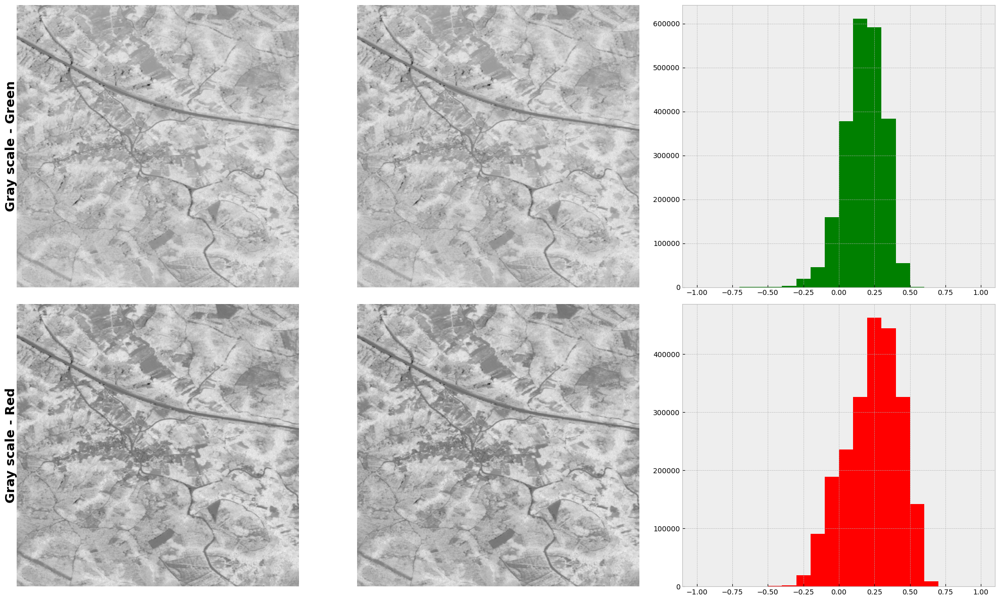

In [97]:
data = [[array1_green, norm_perc_green], [array2_red, norm_perc_red]]
color = ['green', 'red']

# Size of the plot
rows, columns = 2, 3

fig, ax = plt.subplots(rows, columns, figsize=(20, 12))         

for i in range(rows):
    for j in range(columns):
        if j < (columns - 1):
            ax[i, j].imshow(data[i][j], cmap='gray')
            ax[i, j].axis('off')
            if j == 0:
                label = ax[i, j].text(-0.02, 0.5, f'Gray scale - {color[i].capitalize()}',
                                      rotation=90, va='center', ha='center', fontweight='bold', fontsize=18,
                                      transform=ax[i, j].transAxes)
            else:
                None
        else:
            ax[i, j].hist(data[i][0].ravel(), 20, [-1, 1], color=color[i])

plt.show()

### Veget parameter

In [98]:
g_perc = [50, 59, 70, avg_green*100]
r_perc = [50, 55, 70, avg_red*100]
#zzg2_perc = [50, 60, 70, avg_green2*100]

# Green picture normalized in percentage and rounded in g_perc
picture_green_50 = np.round(norm_perc_green)
picture_green_60 = np.floor(np.divide(np.ceil(np.multiply(norm_perc_green,100)),(g_perc[1])))
picture_green_70 = np.floor(np.divide(np.ceil(np.multiply(norm_perc_green,100)),(g_perc[2])))

picture_green_mean = np.floor(np.divide(np.ceil(np.multiply(norm_perc_green,100)),(g_perc[3])))

# Red picture normalized in percentage and rounded in r_perc
picture_red_50 = np.round(norm_perc_red)
picture_red_60 = np.floor(np.divide(np.ceil(np.multiply(norm_perc_red,100)),(r_perc[1])))
picture_red_70 = np.floor(np.divide(np.ceil(np.multiply(norm_perc_red,100)),(r_perc[2])))

picture_red_mean = np.floor(np.divide(np.ceil(np.multiply(norm_perc_red,100)),(r_perc[3])))

'''# Green picture normalized in percentage and rounded in g_perc
picture_green2_50 = np.round(norm_perc_green2).astype(bool)
picture_green2_60 = np.floor(np.divide(np.ceil(np.multiply(norm_perc_green2,100)),(g2_perc[1]))).astype(bool)
picture_green2_70 = np.floor(np.divide(np.ceil(np.multiply(norm_perc_green2,100)),(g2_perc[2]))).astype(bool)

picture_green2_mean = np.floor(np.divide(np.ceil(np.multiply(norm_perc_green2,100)),(g2_perc[3]))).astype(bool)
'''
a = np.array([[2,2],[2,2]])
picture = np.array([picture_green_50, picture_green_60, picture_green_70, picture_red_50, picture_red_60, picture_red_70])

In [99]:
if np.all(picture == picture[0]):
    rows = picture_green_50.shape[0]
    cols = picture_green_50.shape[1]
else:
    rows = image_nir_rgb[0].shape[0]
    cols = image_nir_rgb[0].shape[1]

### Define colors of cmap to present the results (For future developments)

In [100]:
import matplotlib.colors as plt_colors

c_white = plt_colors.colorConverter.to_rgba('white',alpha = 0)
g_70 = plt_colors.colorConverter.to_rgba('green',alpha = 0.7)
r_70 = plt_colors.colorConverter.to_rgba('red',alpha = 0.5)
g = plt_colors.colorConverter.to_rgba('green',alpha = 1)
r = plt_colors.colorConverter.to_rgba('red',alpha = 1)
o = plt_colors.colorConverter.to_rgba('orange',alpha = 1)
c_black= plt_colors.colorConverter.to_rgba('black',alpha = 1)
veget = plt_colors.LinearSegmentedColormap.from_list('rb_cmap',[c_white,g],512)
red = plt_colors.LinearSegmentedColormap.from_list('rb_cmap',[c_white,r],256)
orange = plt_colors.LinearSegmentedColormap.from_list('rb_cmap',[c_white,o],256)
cmap_rb = plt_colors.LinearSegmentedColormap.from_list('rb_cmap',[c_white,c_black],512)
cmap_rbg = plt_colors.LinearSegmentedColormap.from_list('rb_cmap',[c_white,g_70],512)
cmap_rbr = plt_colors.LinearSegmentedColormap.from_list('rb_cmap',[c_white,r_70],512)

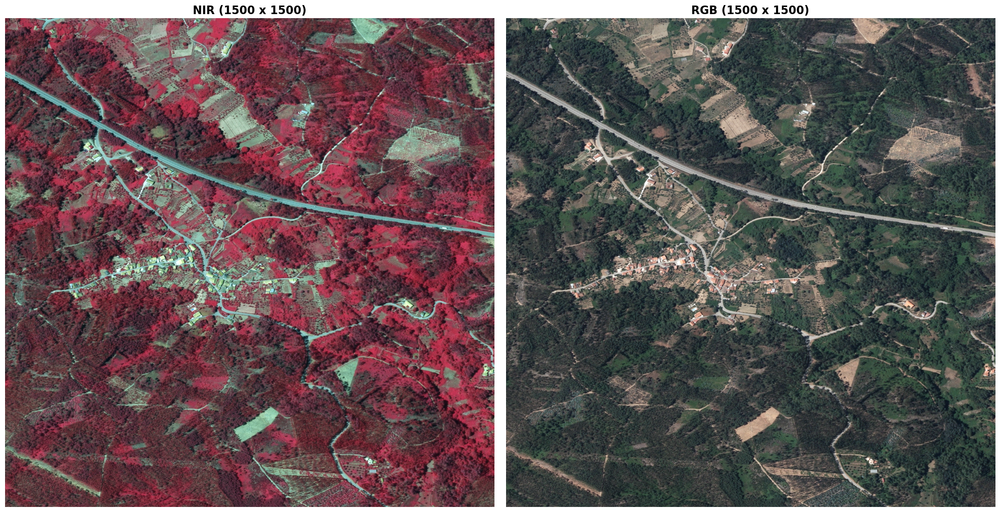

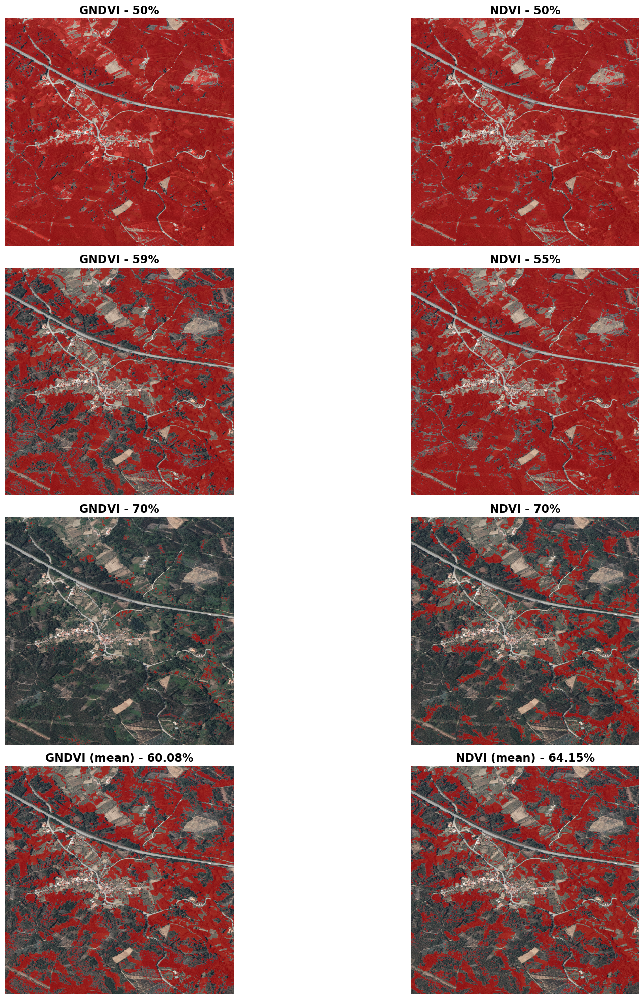

In [101]:
fig, ax = plt.subplots(1,2, figsize=(20, 10))

for idx in range(2):
    ax[idx].imshow(image_nir_rgb[idx])
    ax[idx].axis('off')
    ax[idx].set_title(f'{im_type_color[idx].upper()} ({image_nir_rgb[idx].shape[1]} x {image_nir_rgb[idx].shape[0]})', 
                         fontweight='bold', fontsize='16')


pic = np.array([[picture_green_50, picture_red_50, picture_green_50],# np.invert(picture_green_50)],
                [picture_green_60, picture_red_60, picture_green_60],# np.invert(picture_green_60)],
                [picture_green_70, picture_red_70, picture_green_70],# np.invert(picture_green_70)],
                [picture_green_mean, picture_red_mean, picture_green_mean]])# np.invert(picture_green_mean)]])


labels = np.array([[f'GNDVI - {g_perc[0]}%', f'NDVI - {r_perc[0]}%', f'NDWI - {g_perc[0]}%'],
                   [f'GNDVI - {g_perc[1]}%', f'NDVI - {r_perc[1]}%', f'NDWI - {g_perc[1]}%'],
                   [f'GNDVI - {g_perc[2]}%', f'NDVI - {r_perc[2]}%', f'NDWI - {g_perc[2]}%'],
                   [f'GNDVI (mean) - {np.round(g_perc[3], 2)}%', 
                    f'NDVI (mean) - {np.round(r_perc[3], 2)}%', 
                    f'NDWI (mean) - {np.round(g_perc[3], 2)}%']])


# Size of the plot
rows, columns = 4, 2

fig1, ax1 = plt.subplots(rows, columns, figsize=(20, 20))          

for i in range(rows):
    for j in range(columns):
        ax1[i, j].imshow(image_nir_rgb[1])
        ax1[i, j].imshow(pic[i, j], cmap=cmap_rbr)
        ax1[i, j].axis('off')
        ax1[i, j].set_title(f'{labels[i, j]}', fontweight='bold', fontsize='16')

plt.show()

## 3. Prepare the required files for WUIX2 based on the identified vegetation and vectors of existing houses

### Chosen extraction method - GNDVI

Among the three tested indices, the Green Normalized Difference Vegetation Index - GNDVI is considered the most appropriate for the sequence of the study.

#### Save file
* asc_01 - just numbers
* asc_01 - just headings
* veget - complete file

In [102]:
def create_asc_header(village_attributes):
    xllcorner = str(f'{village["bounds"]["minx"] : .12f}')
    yllcorner = str(f'{village["bounds"]["miny"] : .12f}')

    heading_file = [[f'ncols         {village["size"][0]}'],
                    [f'nrows         {village["size"][1]}'],
                    [f'xllcorner     {xllcorner}'],
                    [f'yllcorner     {yllcorner}'],
                    [f'cellsize      {village["size_Rf"]}'],
                    [f'NODATA_value  {village["nodata_value"]}']]
                
    heading_file = np.array(heading_file).astype('str')

    return heading_file

In [103]:
# veget.asc temporary header
np.savetxt(f'../wui_application/outputs/{village["name"]}/asc_02.asc', 
           create_asc_header(village_attributes=village), fmt='%s')


# veget.asc temporary body
np.savetxt(f'../wui_application/outputs/{village["name"]}/asc_01.asc', 
           picture_green_60.astype(int), fmt='%i', delimiter=" ")

In [104]:
df1 = pd.read_csv(f'../wui_application/outputs/{village["name"]}/asc_02.asc', header=None)
df2 = pd.read_csv(f'../wui_application/outputs/{village["name"]}/asc_01.asc', header=None)
df2

,0
0,1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 ...
1,1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 ...
2,1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 ...
3,1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 ...
4,1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 ...
...,...
1495,1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 ...
1496,1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 ...
1497,1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0 ...
1498,1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 ...


In [105]:
final_file = pd.concat((df1, df2), axis=0)
final_file

,0
0,ncols 1500
1,nrows 1500
2,xllcorner -8.238677953804
3,yllcorner 39.915521016488
4,cellsize 1
...,...
1495,1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 ...
1496,1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 ...
1497,1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0 ...
1498,1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 ...


In [106]:
final_file.to_csv(f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/veget.asc', 
                  header=False, index=False)

### Preparation of the houses

#### Import shapefile of the buildings and print it onto an image Geotiff

In [114]:
import rasterio
from rasterio.transform import from_origin
from rasterio import features

image_buildings = gpd.read_file(f'../data/shape_files/{village["name"]}/buildings/{village["name"]}.shp')
buildins_printed_path = f'../wui_application/images/{village["name"]}/{village["year"]}/buildings_{village["size_Rf"]}.tif'
    
if os.path.exists(buildins_printed_path):
        os.remove(buildins_printed_path)

def convert_transform_dim(village_attributes):

        # Convert the size of the image from degrees to pixels, to apply for outputs
        pixel_conversion_width = (village['bounds']['maxx'] - village['bounds']['minx']) / village['size'][0]
        pixel_conversion_height = (village['bounds']['maxy'] - village['bounds']['miny']) / village['size'][1]

        transform = from_origin(village['bounds']['minx'], 
                                village['bounds']['maxy'], 
                                pixel_conversion_width, 
                                pixel_conversion_height)
        return transform

with rasterio.open(buildins_printed_path, 'w', driver='GTiff', height=village['size'][1], width=village['size'][0],
                   count=1, dtype='uint8', crs='EPSG:4326', transform=convert_transform_dim(village), dpi=600) as dst:
    
    # Print the shapefile's geometry onto the raster
    shapes = ((geom, 255) for geom in image_buildings.geometry) 
    printed = features.rasterize(shapes=shapes, out_shape=(village['size'][1], village['size'][0]),
                                 fill=0, transform=dst.transform, all_touched=True)
    dst.write(printed,1)

In [ ]:
image_buildings

,id,fire_affec,geometry
0,1,build_affec,"POLYGON ((-8.23404 39.92467, -8.23400 39.92470..."
1,2,surro_affec,"POLYGON ((-8.23412 39.92473, -8.23421 39.92478..."
2,3,surro_affec,"POLYGON ((-8.23400 39.92477, -8.23397 39.92480..."
3,4,no_affec,"POLYGON ((-8.23497 39.92475, -8.23509 39.92485..."
4,5,surro_affec,"POLYGON ((-8.23489 39.92466, -8.23483 39.92462..."
...,...,...,...
176,177,build_affec,"POLYGON ((-8.23380 39.92256, -8.23383 39.92255..."
177,178,build_affec,"POLYGON ((-8.23381 39.92252, -8.23378 39.92253..."
178,179,build_affec,"POLYGON ((-8.23380 39.92214, -8.23375 39.92216..."
179,180,surro_affec,"POLYGON ((-8.23625 39.92504, -8.23637 39.92510..."


In [ ]:
i = image_buildings.stack().value_counts()
print(i)

build_affec                                                                                                                                                                                                                                                                                                                                                                                                                                                                           74
surro_affec                                                                                                                                                                                                                                                                                                                                                                                                                                                                           73
no_affec                                              

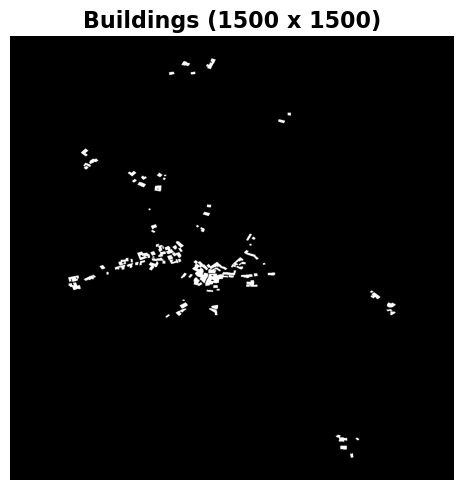

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(10, 5))

image_buildings = np.array(plt.imread(buildins_printed_path)).astype(bool)
ax.imshow(image_buildings, cmap='gray')
ax.axis('off')
ax.set_title(f'Buildings ({image_buildings.shape[1]} x {image_buildings.shape[0]})',
             fontweight='bold', fontsize='16');

#### Save file
* asc_03 - just numbers
* asc_04 - just headings
* veget - complete file

In [ ]:
# house.asc temporary header
np.savetxt(f'../wui_application/outputs/{village["name"]}/asc_04.asc',
           create_asc_header(village_attributes=village), fmt='%s')

# house.asc temporary body
np.savetxt(f'../wui_application/outputs/{village["name"]}/asc_03.asc', 
           image_buildings.astype(int), fmt='%i', delimiter=" ")

In [ ]:
df3 = pd.read_csv(f'../wui_application/outputs/{village["name"]}/asc_04.asc', header=None)
df4 = pd.read_csv(f'../wui_application/outputs/{village["name"]}/asc_03.asc', header=None)
df3

,0
0,ncols 1500
1,nrows 1500
2,xllcorner -8.238677953804
3,yllcorner 39.915521016488
4,cellsize 1
5,NODATA_value 0


In [ ]:
final_file_house = pd.concat((df3, df4), axis=0)
final_file_house

,0
0,ncols 1500
1,nrows 1500
2,xllcorner -8.238677953804
3,yllcorner 39.915521016488
4,cellsize 1
...,...
1495,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...
1496,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...
1497,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...
1498,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...


In [ ]:
final_file_house.to_csv(f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/house.asc',
                        header=False, index=False)

In [ ]:
# Delete temporary files
temp_path = f'../wui_application/outputs/{village["name"]}/asc_0'
for x in range(4):
    if os.path.exists(f'{temp_path}{x+1}.asc'):
        os.remove(f'{temp_path}{x+1}.asc')

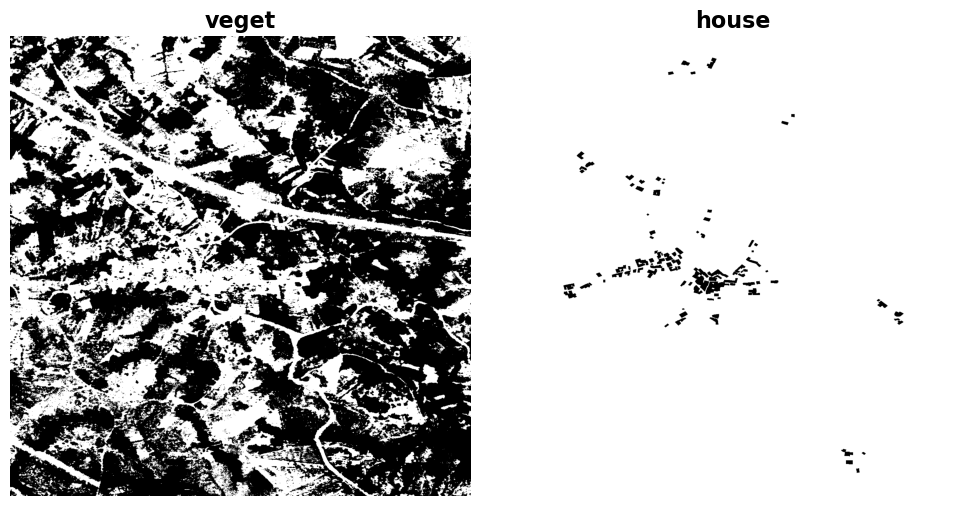

In [ ]:
label_data = ['veget', 'house']

fig, ax = plt.subplots(1,2, figsize=(10, 5))

for idx in range(2):
    binary_data = pd.read_csv(f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/{label_data[idx]}.asc', 
                              sep=' ', header=None, skiprows=[0,1,2,3,4,5,6,7], engine='python')
    ax[idx].imshow(binary_data, cmap='binary')
    ax[idx].axis('off')
    ax[idx].set_title(f'{label_data[idx]}', fontweight='bold', fontsize='16')

plt.show()

## 4. Apply the WUIX methodology through the WUIX2 software

In [ ]:
from math import trunc


ncell = trunc(float(village["size_Rf"]))
big_cell = trunc(float(village["n_number"])) * ncell
outputs = ['CONT', 'FRIC', 'URBA', 'WUIX']
out_type = ['UNIT', 'NORM', 'SPEC', 'TOTAL']

wuix2_input = ['house', 'veget']
wuix2_output = []
wuix2_output_higher = [f'Tipos_IUF_{big_cell}']

for i in outputs:
    wuix2_output.append(f'{i}_{out_type[0]}_{ncell}')

for i in outputs:
    for j in out_type:
        if j != out_type[0]:
            wuix2_output_higher.append(f'{i}_{j}_{ncell}_{big_cell}')

print(' Fine cell: ', ncell, '\n', 'Large cell: ', big_cell)
print(wuix2_output, '\n', wuix2_output_higher)

 Fine cell:  1 
 Large cell:  40
['CONT_UNIT_1', 'FRIC_UNIT_1', 'URBA_UNIT_1', 'WUIX_UNIT_1'] 
 ['Tipos_IUF_40', 'CONT_NORM_1_40', 'CONT_SPEC_1_40', 'CONT_TOTAL_1_40', 'FRIC_NORM_1_40', 'FRIC_SPEC_1_40', 'FRIC_TOTAL_1_40', 'URBA_NORM_1_40', 'URBA_SPEC_1_40', 'URBA_TOTAL_1_40', 'WUIX_NORM_1_40', 'WUIX_SPEC_1_40', 'WUIX_TOTAL_1_40']


In [ ]:
# Making the files available for the software
output_sys_path = f'..\\wui_application\\outputs\\"{village["name"]}"\\{village["year"]}\\resolution_{village["size_Rf"]}\\'
method_sys_path = '..\\metodology\\WUIX2\\'

for x in wuix2_input:
    os.system(f'copy {output_sys_path}{x}.asc {method_sys_path}{x}.asc')

# run the software
os.system(f'{method_sys_path}WUIX2.exe /Gr={village["n_number"]}')

# Collecting the output files and pasting in the specific village-output folder

for x in wuix2_input:
    os.remove(f'../metodology/WUIX2/{x}.asc')

for x in wuix2_output + wuix2_output_higher:
    if os.path.exists(f'{method_sys_path}{x}.asc'):
        os.system(f'copy {method_sys_path}{x}.asc {output_sys_path}{x}.asc')
        os.remove(f'{method_sys_path}{x}.asc')

## 5. Show preliminary results and apply the standardized colour plot

### Presentation of the results separately

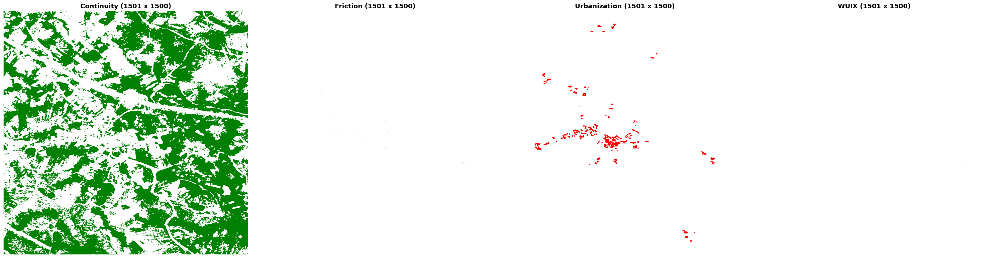

In [ ]:
cmaps = [veget, cmap_rb, red, orange]

graph = []
graph_names = ['Continuity', 'Friction', 'Urbanization', 'WUIX']

for x in wuix2_output:
    if os.path.exists(f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/{x}.asc'):
        temp1 = pd.read_csv( f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/{x}.asc', 
                             sep=' ', header=None, skiprows=[0,1,2,3,4,5,6,7], engine='python')
        temp1 = temp1.to_numpy()
        graph.append(temp1)
        
    else:
        print('Impossible to find the file path \n')
        break


fig, ax = plt.subplots(1,4, figsize=(30, 10), facecolor='white')


for x in range(len(graph_names)):
    ax[x].imshow(graph[x], cmap=cmaps[x])
    ax[x].set_title(f'{graph_names[x]} ({graph[x].shape[1]} x {graph[x].shape[0]})',
                    fontweight='bold', fontsize='14')
    ax[x].axis('off')

plt.show(fig, ax);

### Check if all of the channels have the same size

In [ ]:
image_nir_rgb[0].shape, image_nir_rgb[1].shape, image_buildings.shape

for x in range(len(graph)):
    
    
    y = nir_channel.shape == green_channel.shape  == red_channel.shape == image_buildings.shape == (graph[x].shape[0], graph[x].shape[1] - 1)
    
    print(x+1, y, nir_channel.shape)


1 True (1500, 1500)
2 True (1500, 1500)
3 True (1500, 1500)
4 True (1500, 1500)


### Convert image to the original size
* Reset the cellsize value to the real value

In [ ]:
final_file_house

,0
0,ncols 1500
1,nrows 1500
2,xllcorner -8.238677953804
3,yllcorner 39.915521016488
4,cellsize 1
...,...
1495,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...
1496,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...
1497,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...
1498,0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 ...


In [ ]:
# Calculate the value for cellsize through the expression 
# 'cellsize = ((1000 + x_west) - (1000 + x_east)) / n_of_pixels_xdirection)' 

# this number is converted into a string with 12 decimal numbers

cellsize_real = str(f'{(abs((village["bounds"]["minx"] - village["bounds"]["maxx"]) / village["size"][0]) / village["size_Rf"]) :.12f}')

outputs_path = f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/'

for x in wuix2_input:
    if os.path.exists(outputs_path + f'{x}.asc'):
        final_file = pd.read_csv(outputs_path + f'{x}.asc', sep='!!', header=None, engine='python')
        
        final_file.iloc[4,0] = f"cellsize      {cellsize_real}"
        final_file.to_csv(outputs_path + f'{x}.asc', header=False, index=False)

for x in wuix2_output:
    if os.path.exists(outputs_path + f'{x}.asc'):
        temp1 = pd.read_csv(outputs_path + f'{x}.asc', sep='!!', header=None, engine='python')
        
        temp1.iloc[4,0] = f"cellsize      {cellsize_real}"
        temp1.to_csv(outputs_path + f'{x}.asc', header=False, index=False)

# Multiply the cellsize by the n_number to reduce the image to the normal size
cellsize_real_higher = np.array(cellsize_real).astype(np.float64) * big_cell
cellsize_real_higher = str(f'{cellsize_real_higher : .12f}')

for x in wuix2_output_higher:
    if os.path.exists(outputs_path + f'{x}.asc'):
        temp1 = pd.read_csv(outputs_path + f'{x}.asc', sep='!!', header=None, engine='python')
                             
        temp1.iloc[4,0] = f"cellsize      {cellsize_real_higher}"
        temp1.to_csv(outputs_path + f'{x}.asc', header=False, index=False)


### Show the existent types of WUI 

In [ ]:
# Load data from csv with recommended color combinations by the methodology

wuix_colors = pd.read_csv('../data/WUIX_colors/colors_CONT_FRIC.csv', usecols=['R', 'G', 'B', 'Legend', 'Index'], sep=';')
wuix_colors.head()

,Index,R,G,B,Legend
0,1,255,255,255,Void
1,2,178,255,178,Sparse vegetation
2,3,0,255,0,Medium vegetation
3,4,0,168,0,Dense vegetation
4,5,0,84,0,Very dense vegetation


In [ ]:
wuix_colors = wuix_colors.to_numpy()
wuix_colors[:1]

array([[1, 255, 255, 255, 'Void']], dtype=object)

In [ ]:
wui_type = pd.read_csv(f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/Tipos_IUF_{big_cell}.asc', 
                       sep=' ', header=None, skiprows=[0,1,2,3,4,5], engine='python')
wui_type = wui_type.to_numpy()
wui_type = np.reshape(wui_type, (wui_type.shape[0], wui_type.shape[1], 1))

In [ ]:
# Determine unique values in wui_type
unique_values = np.unique(wui_type)

# Create a custom legend based on unique_values
legend_labels = [wuix_colors[value - 1, 4] for value in unique_values]

x = 0
im = wui_type

while x < wuix_colors.shape[0]:

    im = np.where(im != x+1, im, [wuix_colors[x,1], wuix_colors[x,2], wuix_colors[x,3]])
    x+=1
    
im.shape


(37, 37, 3)

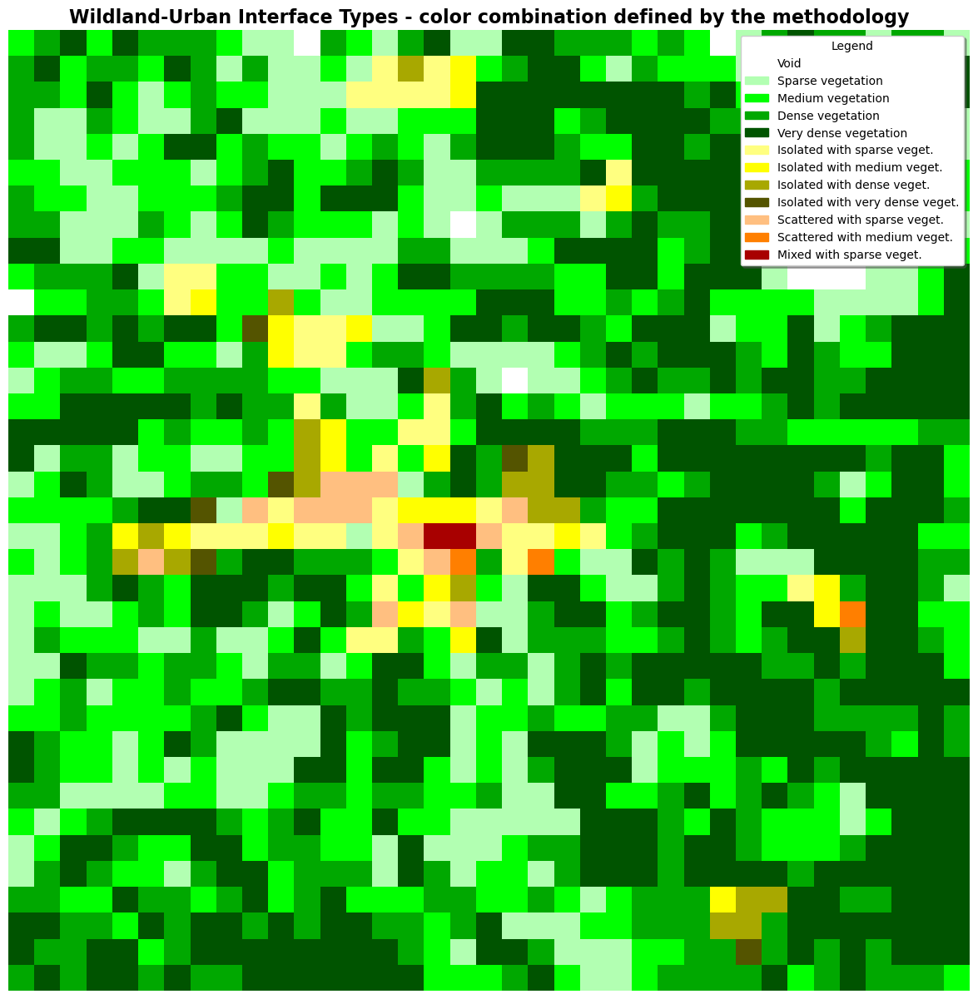

In [ ]:
from matplotlib.patches import Patch
plt.style.use('default')

types_WUI_path = f'../wui_application/outputs/{village["name"]}/{village["year"]}/resolution_{village["size_Rf"]}/Tipos_IUF_{big_cell}.'

fig, ax = plt.subplots(1,1, figsize=(15, 15))

ax.imshow(im)
ax.axis('off')
ax.set_title(f'Wildland-Urban Interface Types - color combination defined by the methodology', 
             fontweight='bold', fontsize='16')

# Create a legend based on legend_labels
handles = [Patch(color=tuple(wuix_colors[unique_values[i] - 1, 1:4] / 255), label=label)
           for i, label in enumerate(legend_labels)]

# Add the legend outside the image plot
ax.legend(handles=handles, title='Legend', shadow=True)

plt.plot()

plt.savefig(types_WUI_path + 'png', dpi=600, bbox_inches='tight')

In [ ]:
# print the image in Geotiff format
with rasterio.open(types_WUI_path + 'tif', 'w', driver='GTiff', height=village['size'][1], width=village['size'][0],
                   count=3, dtype='uint8', crs='EPSG:4326', transform=convert_transform_dim(village), dpi=600) as dst:
        for channel_num in range(3):
                dst.write(im[:, :, channel_num], channel_num + 1)